In [1]:
from matplotlib import pyplot
pyplot.rcParams['figure.dpi'] = 200
pyplot.rcParams['savefig.dpi'] = 200

from sys import platform
import sys
if platform == "linux" or platform == "linux2" or platform == "darwin":
    sys.path.append("../../")

In [2]:
%matplotlib widget
from IPython.display import Image
from src.tests.tester import Tester
from src.lab1.methods import NMMethod
from src.lab1.method_processor import MethodProcessor
from src.metric import CallCount, GradientCount, PrecisionCount
from src.common.oracul import LambdaOracul, PoweredSumOracul, GradientLambdaOracul, MultiGradientLambdaOracul

from src.lab1.stop_condition import CountCondition, PrecisionCondition, AndCondition, OrCondition
import numpy as np
from src.common import Oracul, Point
from src.lab1.method_processor import MethodProcessor
from src.lab1.methods import GoldenRatioMethod, GradientDescent, BaseGradientDescent, DichotomyMethod, \
    CoordinateDescent
from scipy.optimize import minimize
import numpy as np
import matplotlib.pyplot as plt

nm_3 = NMMethod(0.001)
nm_2 = NMMethod(0.01)
nm_1 = NMMethod(0.1)
coordinate_descent_1 = CoordinateDescent(eps=0.1)
coordinate_descent_2 = CoordinateDescent(eps=0.01)
coordinate_descent_3 = CoordinateDescent(eps=0.001)


In [3]:
golden_ratio = GoldenRatioMethod()
gradient_descent_fix = BaseGradientDescent()
gradient_descent_golden = GradientDescent()
gradient_descent_dichotomy = GradientDescent(method=DichotomyMethod())
gradient_descent_golden_2 = GradientDescent(aprox_dec=0.01)
gradient_descent_dichotomy_2 = GradientDescent(method=DichotomyMethod(), aprox_dec=0.01)
gradient_descent_golden_1 = GradientDescent(aprox_dec=0.1)
gradient_descent_dichotomy_1 = GradientDescent(method=DichotomyMethod(), aprox_dec=0.1)
oracul = LambdaOracul(lambda x: (x - 10) ** 2)
gradient_oracul = GradientLambdaOracul(lambda x, y: (x - 10) ** 2 + (y - 5) ** 2,
                                       lambda x, y: np.array([2 * (x - 10), 2 * (y - 5)], dtype=np.float64))

In [4]:
base_test = GradientLambdaOracul(lambda x, y: x ** 2 + y ** 2,
                                 lambda x, y: np.array([2 * x, 2 * y], dtype=np.float64))
base_differential = GradientLambdaOracul(lambda x, y: 0.26 * (x ** 2 + y ** 2) - 0.48 * x * y,
                                         lambda x, y: np.array([0.52 * x - 0.48 * y, 0.52 * y - 0.48 * x],
                                                               dtype=np.float64))
bad_defined_base = GradientLambdaOracul(lambda x, y: 100 * x ** 2 + y ** 2,
                                        lambda x, y: np.array([200 * x, 2 * y], dtype=np.float64))

In [5]:
abs_prec_1 = PrecisionCount(0.1)
abs_prec_2 = PrecisionCount(0.01)
abs_prec_3 = PrecisionCount(0.001)

/Users/mike/Documents/Methods-of-optimization/presentation/lab-1/../../src/visualization/animator.py:100: UserWarning: The following kwargs were not used by contour: 'rstride', 'cstride'
  contur_ax.contour(xgrid, ygrid, zgrid, rstride=4, cstride=4)


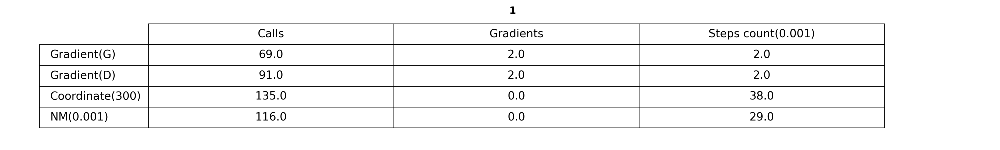

[[Point(coordinates=array([2.05303102e-05, 4.10606204e-05, 2.10746819e-09])), Point(coordinates=array([-1.21306236e-05, -2.42612472e-05,  7.35760144e-10])), Point(coordinates=array([ 3.81469727e-04, -3.81469727e-04,  2.91038305e-07])), Point(coordinates=[0.2084490843117237, 0.003098994493484497, 0.04346062451726675])]]


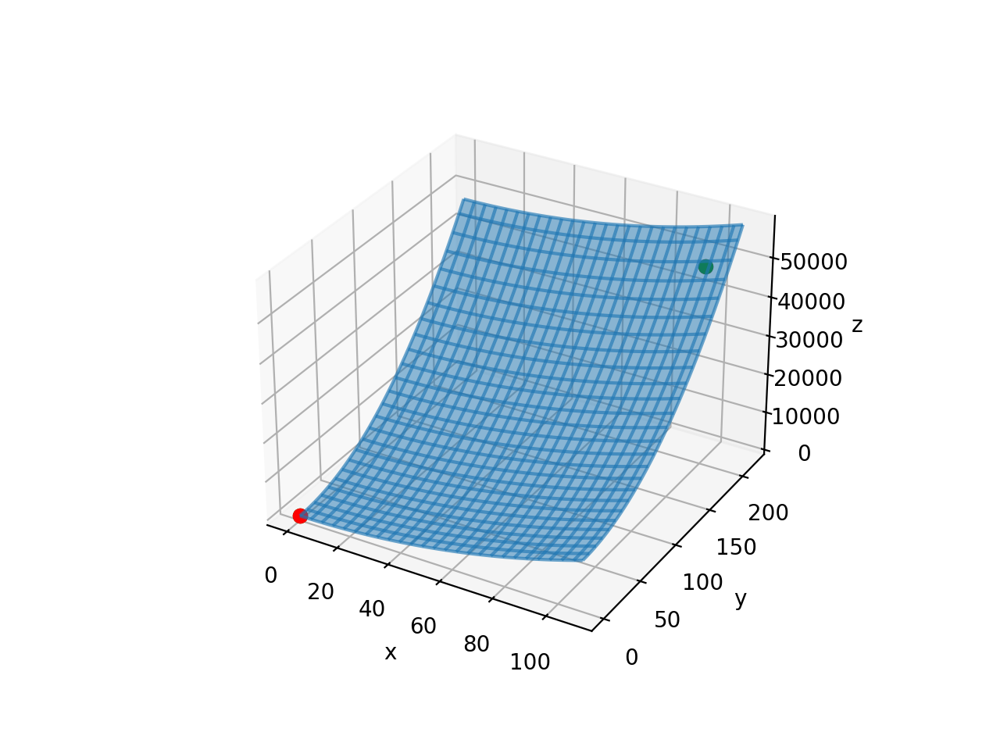

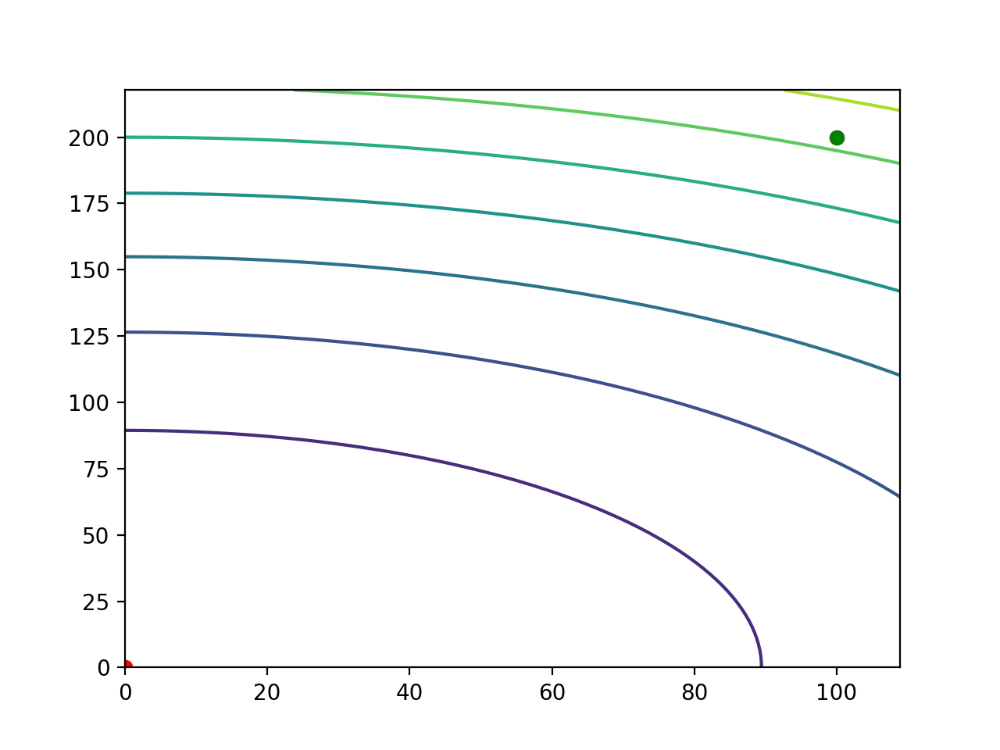

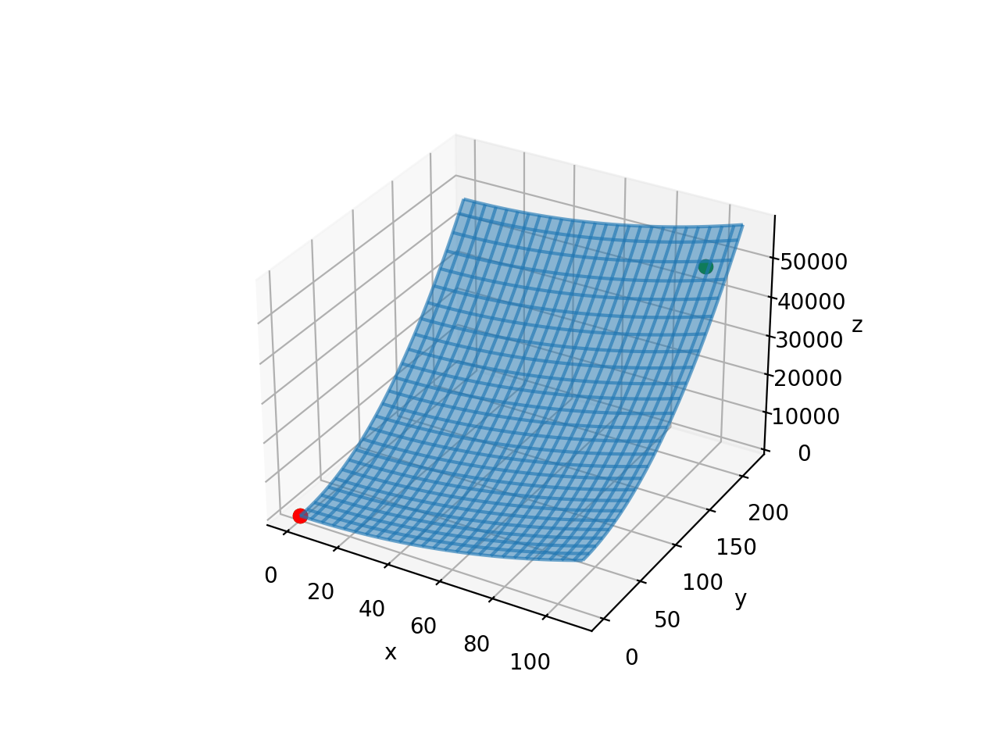

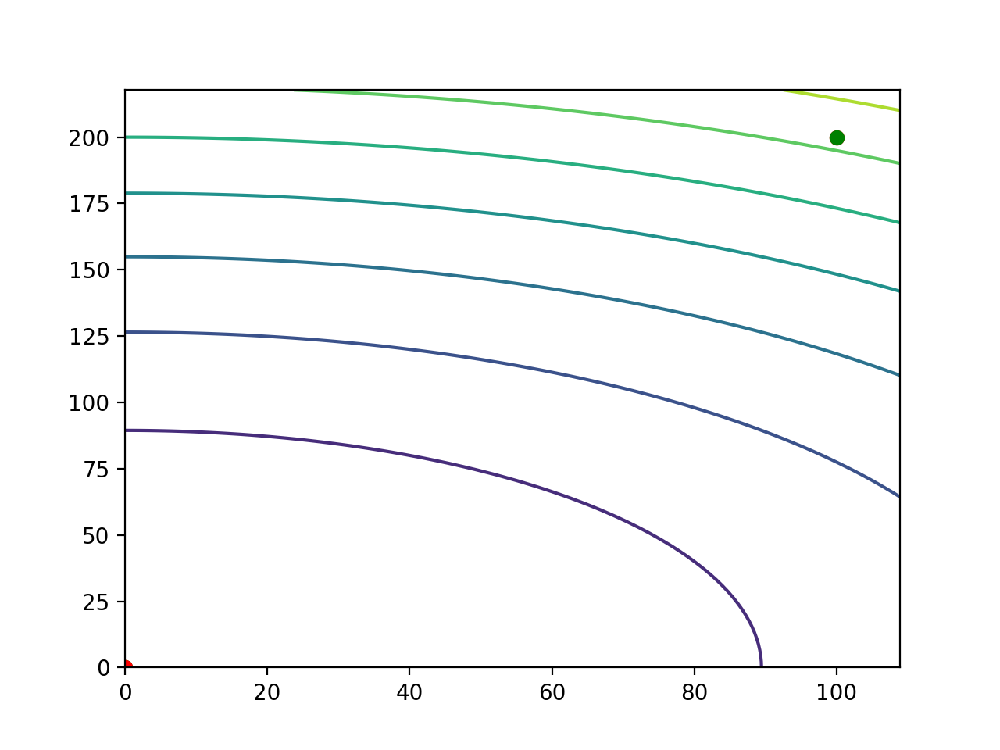

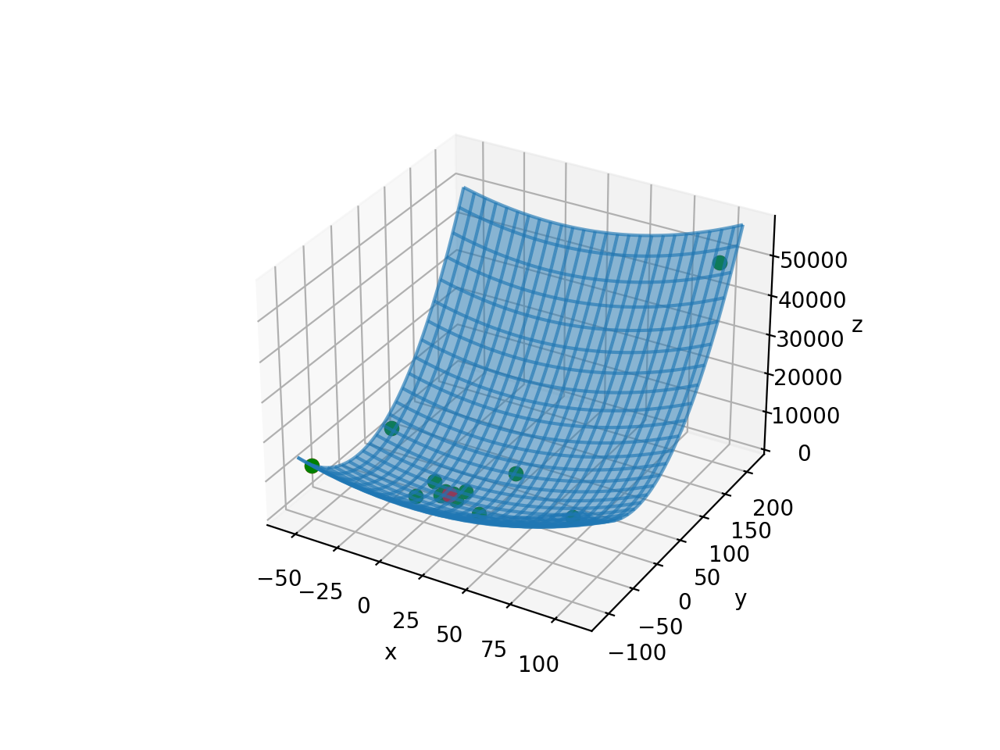

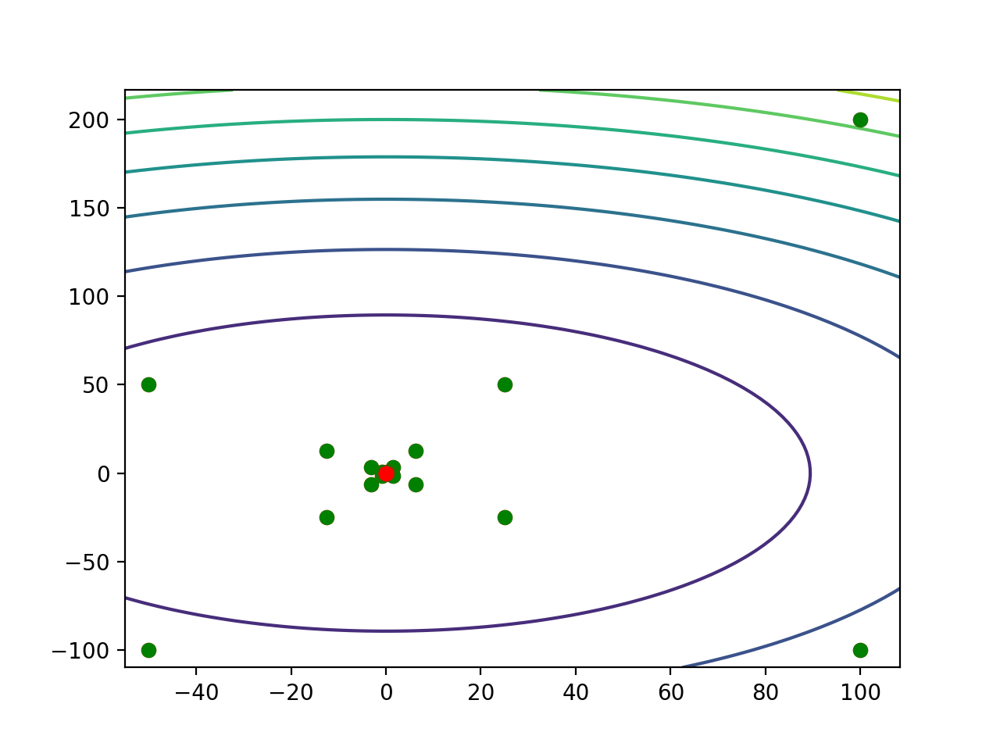

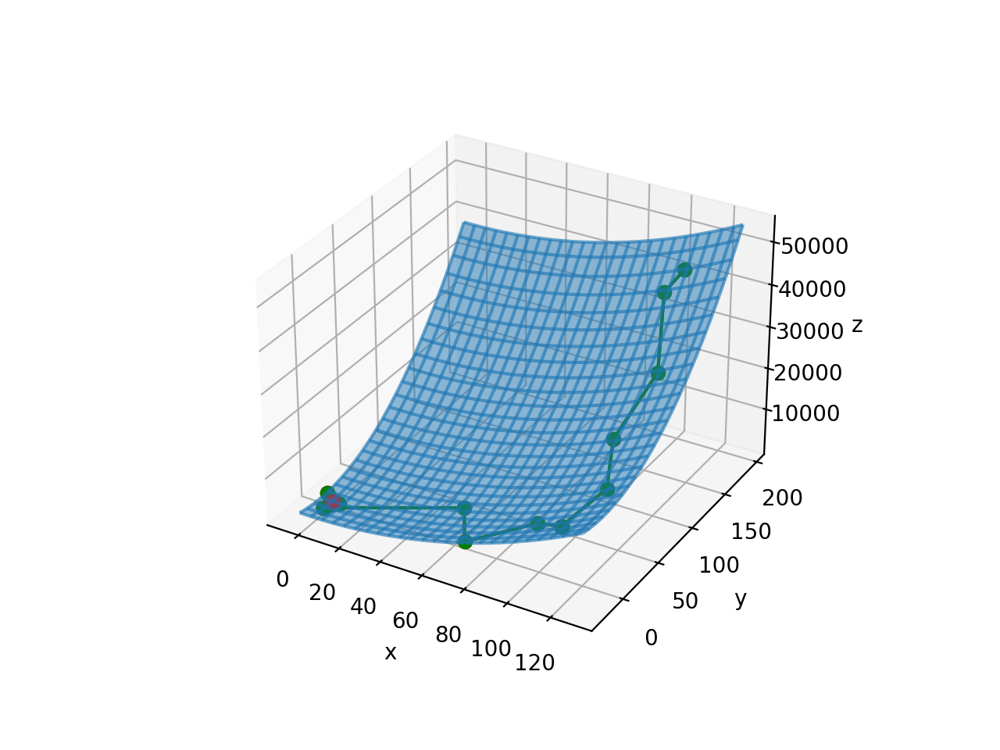

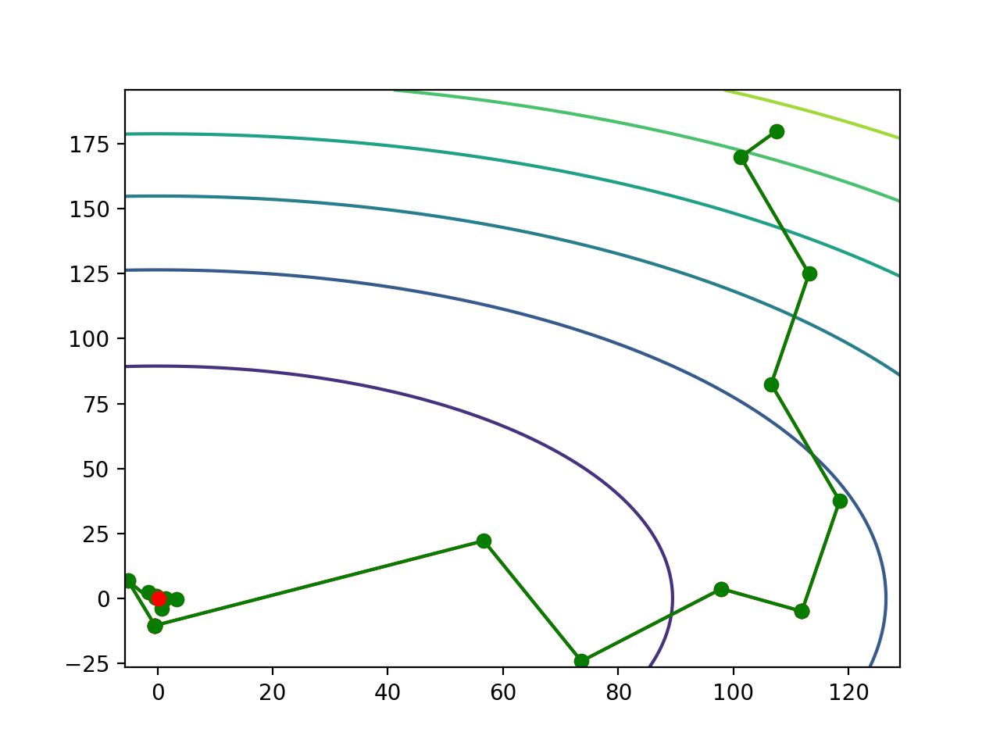

In [6]:
points, anims = Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3],
            [base_test], [CallCount(), GradientCount(), abs_prec_3],
            OrCondition(CountCondition(5000), PrecisionCondition(0.001)), visualize=True,
            start_point=[100, 200])
print(points)

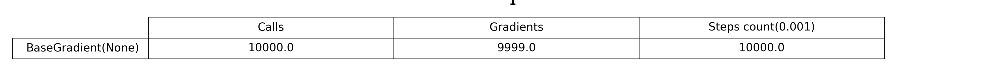

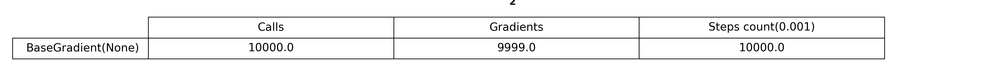

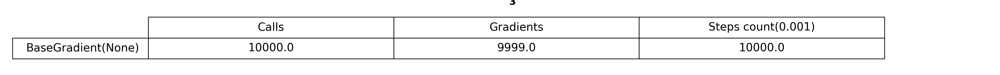

([[Point(coordinates=array([-0.04168131, -0.08336263,  0.00868666]))],
  [Point(coordinates=array([3.86964528e-02, 3.86964528e-02, 5.98966185e-05]))],
  [Point(coordinates=array([ 5.17021769e-003, -9.88131292e-324,  2.67311510e-003]))]],
 [None, None, None])

In [7]:
Tester.test([BaseGradientDescent()], [base_test, base_differential, bad_defined_base],
            [CallCount(), GradientCount(), abs_prec_3], CountCondition(max_count=10 ** 4), learning_rate=0.1,
            start_point=[100, 200])

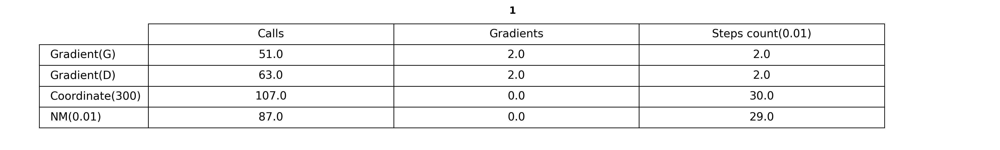

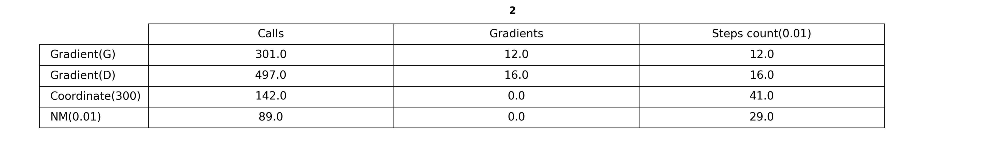

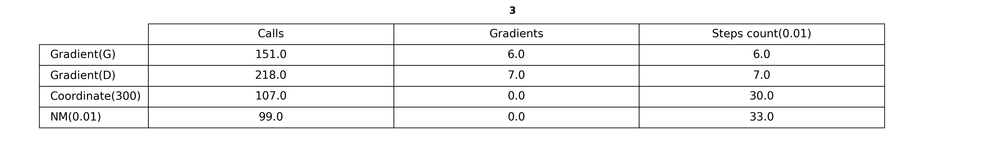

([[Point(coordinates=array([-1.12924171e-03, -2.25848343e-03,  6.37593424e-06])),
   Point(coordinates=array([-7.15849222e-04, -1.43169844e-03,  2.56220054e-06])),
   Point(coordinates=array([ 6.10351562e-03, -6.10351562e-03,  7.45058060e-05])),
   Point(coordinates=[0.2084490843117237, 0.003098994493484497, 0.04346062451726675])],
  [Point(coordinates=array([2.98896808e-02, 3.40890073e-02, 4.53413112e-05])),
   Point(coordinates=array([0.05688377, 0.05956115, 0.00013739])),
   Point(coordinates=array([2.44140625e-02, 3.05175781e-02, 3.94880772e-05])),
   Point(coordinates=[-0.03599001909606159, 0.09701996110379696, 0.004460160246406366])],
  [Point(coordinates=array([-0.00273858,  0.03061871,  0.00168748])),
   Point(coordinates=array([6.11020851e-04, 3.89126596e-03, 5.24765988e-05])),
   Point(coordinates=array([ 0.00610352, -0.00610352,  0.00376254])),
   Point(coordinates=[0.0043273065239191055, -0.23204704280942678, 0.05571838825179523])]],
 [None, None, None, None, None, None, No

In [8]:
Tester.test([gradient_descent_golden_2, gradient_descent_dichotomy_2, coordinate_descent_2, nm_2],
            [base_test, base_differential, bad_defined_base], [CallCount(), GradientCount(), abs_prec_2],
            PrecisionCondition(0.01), start_point=[100, 200])

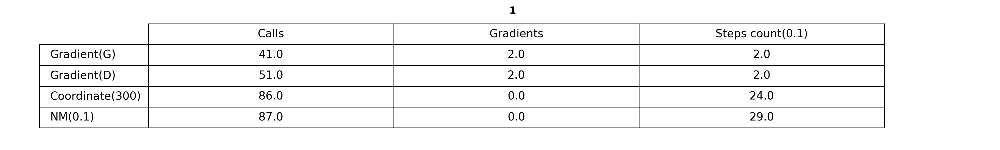

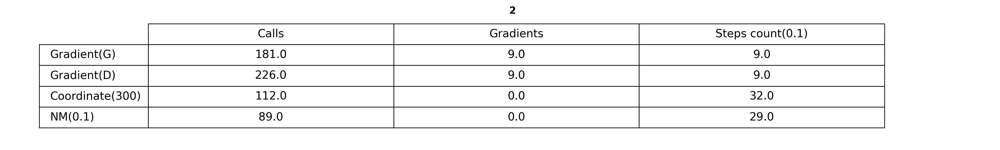

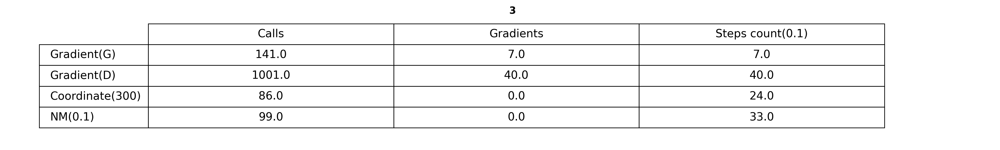

([[Point(coordinates=array([-0.01547988, -0.03095975,  0.00119813])),
   Point(coordinates=array([-7.15849222e-04, -1.43169844e-03,  2.56220054e-06])),
   Point(coordinates=array([-0.04882812,  0.04882812,  0.00476837])),
   Point(coordinates=[0.2084490843117237, 0.003098994493484497, 0.04346062451726675])],
  [Point(coordinates=array([-1.96934881e-02, -5.78316481e-04,  9.54569076e-05])),
   Point(coordinates=array([0.38528515, 0.40674333, 0.0063882 ])),
   Point(coordinates=array([0.24414062, 0.1953125 , 0.00252724])),
   Point(coordinates=[-0.03599001909606159, 0.09701996110379696, 0.004460160246406366])],
  [Point(coordinates=array([0.01221139, 3.12722992, 9.7944788 ])),
   Point(coordinates=array([0.01570476, 2.71359193, 7.38824512])),
   Point(coordinates=array([-0.04882812,  0.04882812,  0.24080276])),
   Point(coordinates=[0.0043273065239191055, -0.23204704280942678, 0.05571838825179523])]],
 [None, None, None, None, None, None, None, None, None, None, None, None])

In [9]:
Tester.test([gradient_descent_golden_1, gradient_descent_dichotomy_1, coordinate_descent_1, nm_1],
            [base_test, base_differential, bad_defined_base], [CallCount(), GradientCount(), abs_prec_1],
            PrecisionCondition(0.1), start_point=[100, 200])

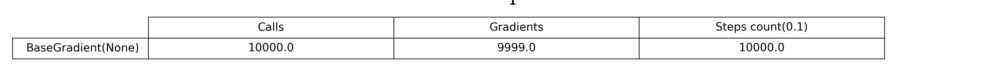

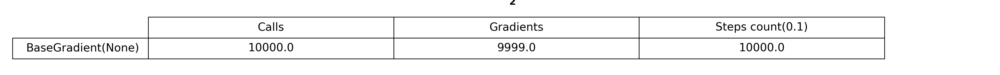

/Users/mike/Documents/Methods-of-optimization/presentation/lab-1/../../src/tests/tester.py:52: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(3 * (len(header) + 3) + 2, 1 + N / 2))


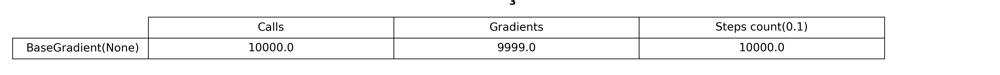

([[Point(coordinates=array([0.2713682 , 0.54273641, 0.36820351]))],
  [Point(coordinates=array([-0.27707295, -0.27707295,  0.00307078]))],
  [Point(coordinates=array([ 5.65335658e-01, -3.02563632e-88,  3.19604406e+01]))]],
 [None, None, None])

In [10]:
Tester.test([BaseGradientDescent()], [base_test, base_differential, bad_defined_base],
            [CallCount(), GradientCount(), abs_prec_1], CountCondition(max_count=10 ** 4), learning_rate=1,
            start_point=[100, 200])

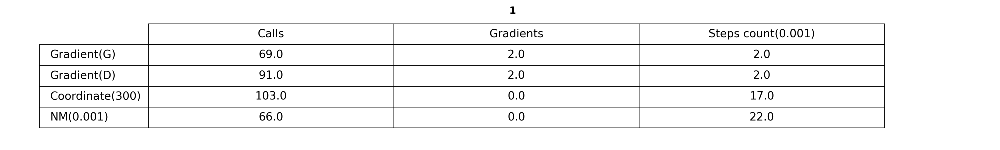

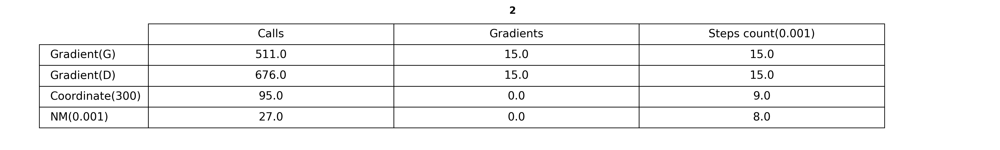

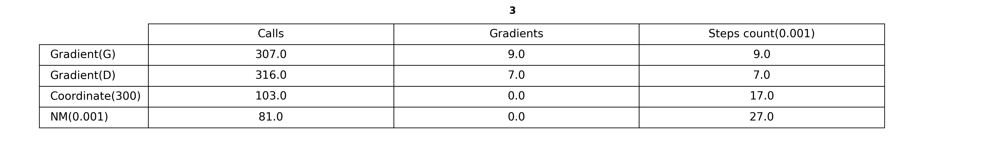

([[Point(coordinates=array([-2.02307770e-05, -4.04615541e-05,  2.04642170e-09])),
   Point(coordinates=array([-1.21306236e-06, -2.42612472e-06,  7.35760144e-12])),
   Point(coordinates=array([1.52587891e-04, 3.05175781e-04, 1.16415322e-07])),
   Point(coordinates=[0.330902099609375, -0.023681640625, 0.11005701962858438])],
  [Point(coordinates=array([2.57991871e-05, 2.12757818e-05, 2.72758257e-11])),
   Point(coordinates=array([6.74583504e-05, 8.93960398e-05, 3.66348551e-10])),
   Point(coordinates=array([1.52587891e-04, 3.05175781e-04, 7.91624188e-09])),
   Point(coordinates=[12.9375, 12.5, 6.518515625000006])],
  [Point(coordinates=array([-3.34063831e-05,  9.77396574e-03,  9.56420049e-05])),
   Point(coordinates=array([-1.93240793e-05,  5.49043676e-04,  3.38790962e-07])),
   Point(coordinates=array([1.52587891e-04, 3.05175781e-04, 2.42143869e-06])),
   Point(coordinates=[-0.017409324645996094, 0.284212589263916, 0.11108525435906813])]],
 [None, None, None, None, None, None, None, Non

In [11]:
Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3],
            [base_test, base_differential, bad_defined_base], [CallCount(), GradientCount(), abs_prec_3],
            PrecisionCondition(0.001), start_point=[10, 20])

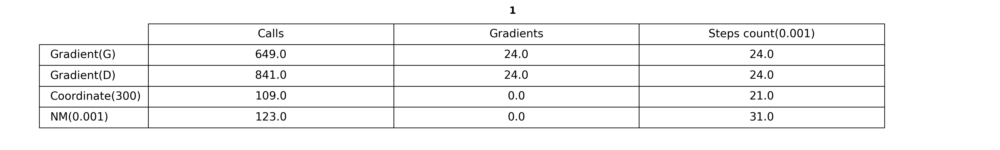

([[Point(coordinates=array([ 9.99996550e+00, -2.00000260e+01,  2.40167314e-42])),
   Point(coordinates=array([ 9.99995262e+00, -2.00000335e+01,  5.72292386e-41])),
   Point(coordinates=array([ 9.99946594e+00, -2.00004578e+01,  1.92787766e-30])),
   Point(coordinates=[9.789821412414312, -20.067488104104996, 0.00016822293204632116])]],
  <matplotlib.animation.ArtistAnimation at 0x169de6b80>])

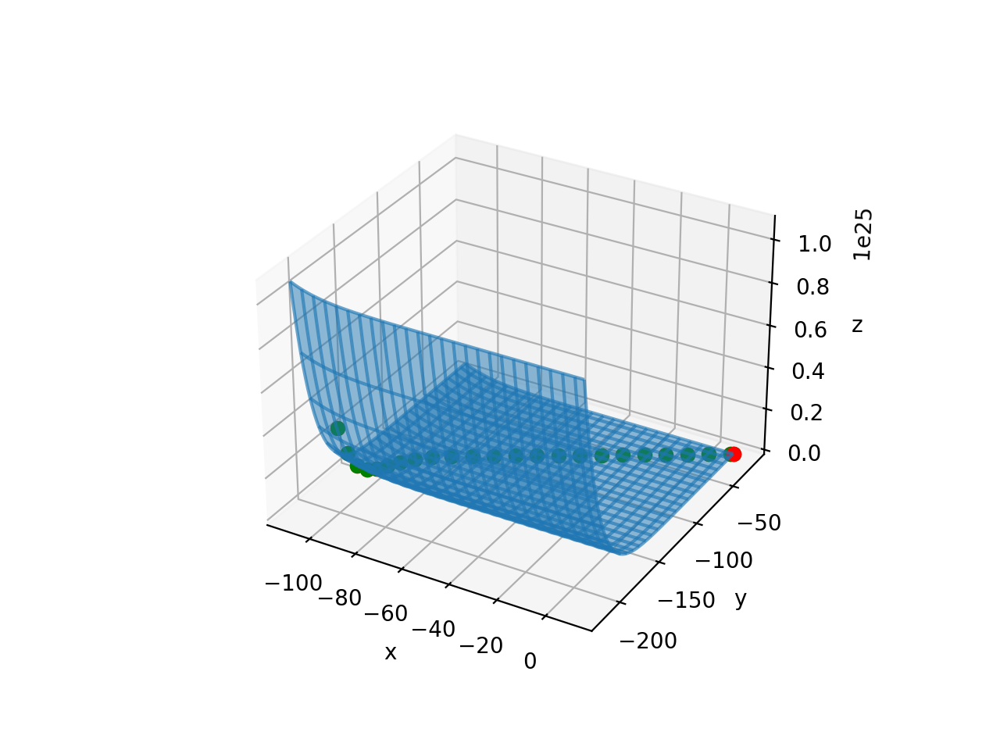

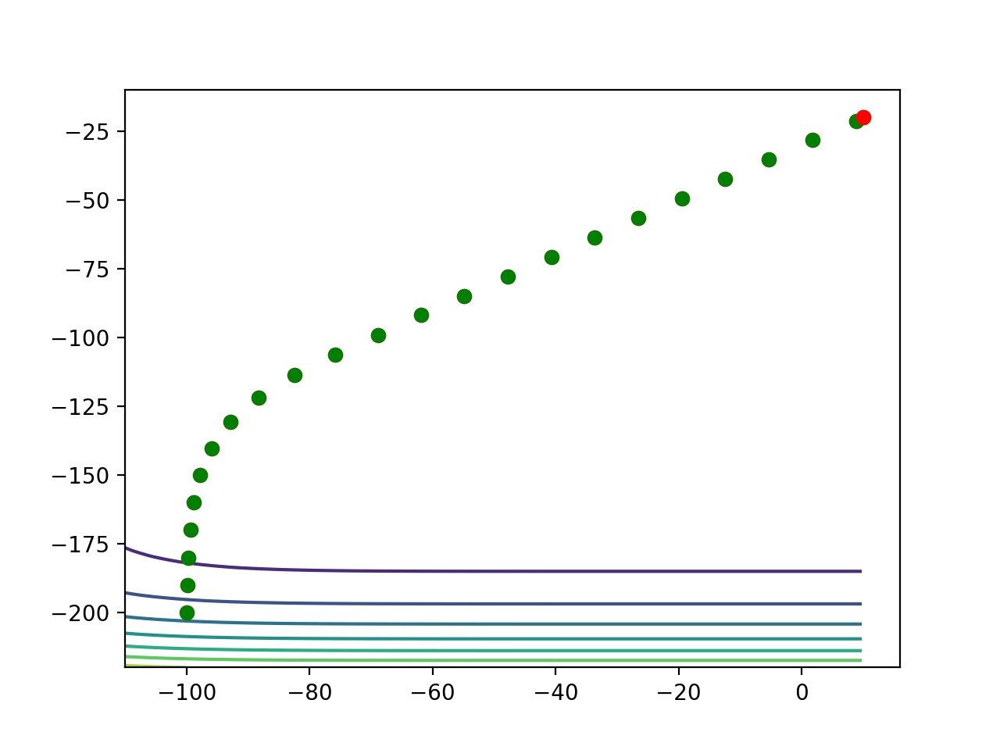

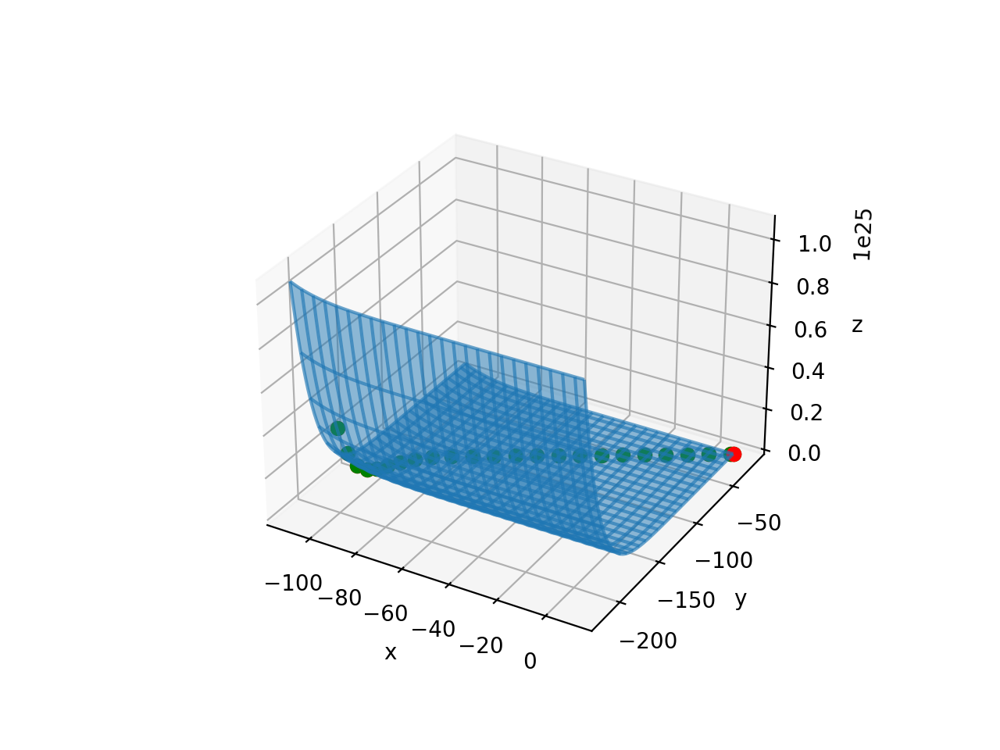

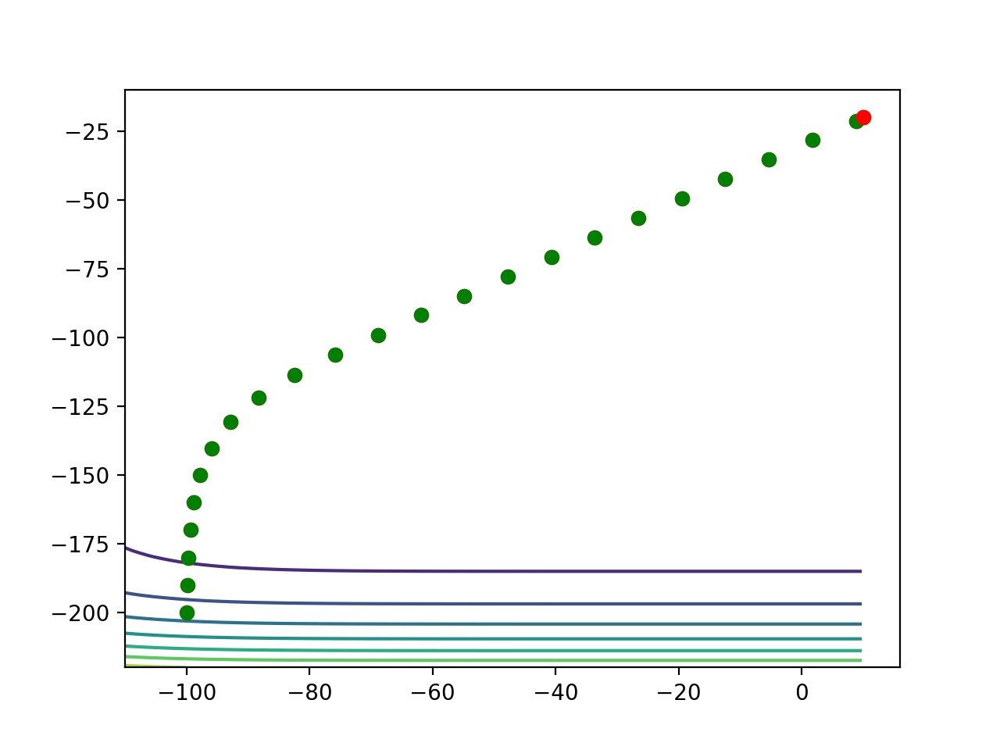

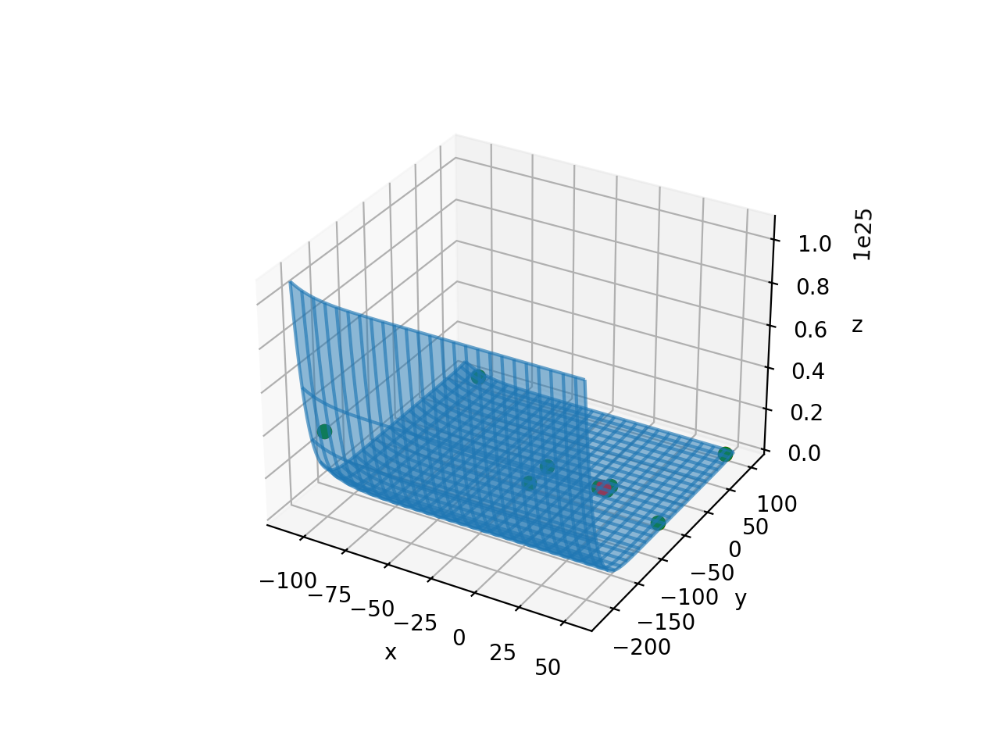

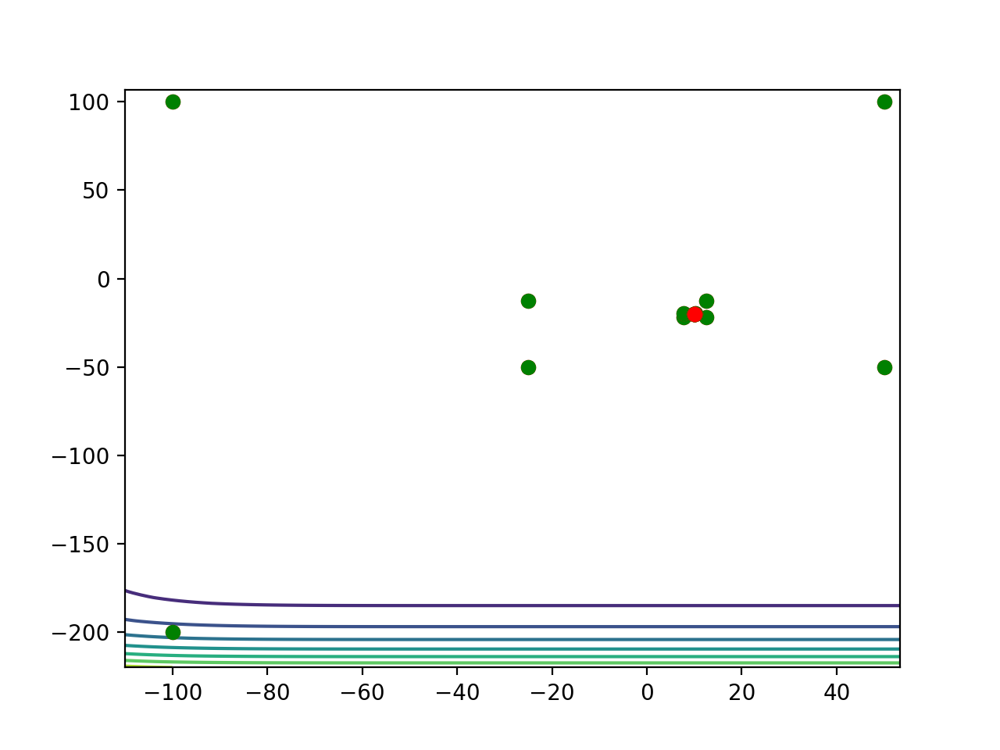

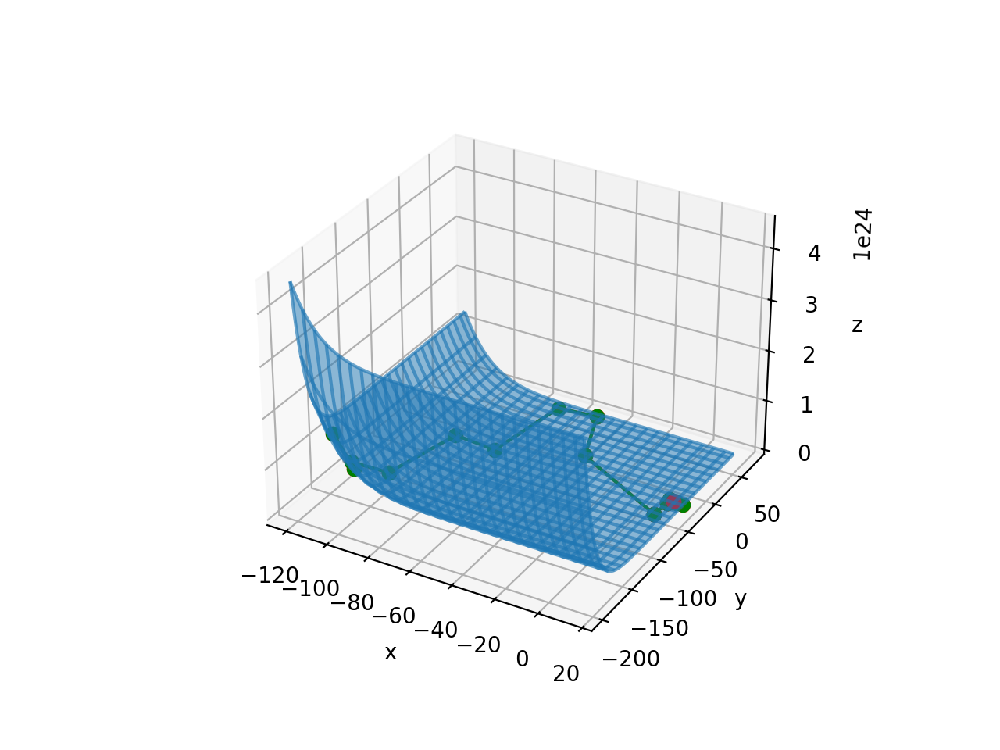

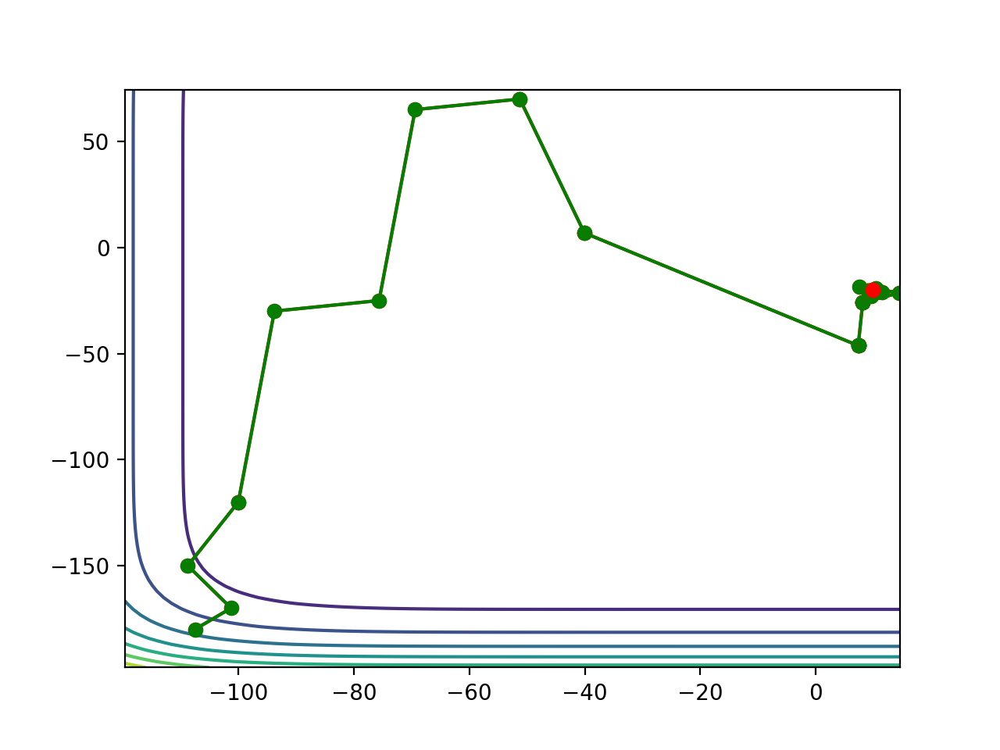

In [12]:
bad_defined = GradientLambdaOracul(lambda x, y: 1000 * (np.float64(x) - 10) ** 10 + 100 * (np.float64(y) + 20) ** 10,
                                   lambda x, y: np.array(
                                       [1000 * (np.float64(x) - 10) ** 9, 1000 * (np.float64(y) + 20) ** 9],
                                       dtype=np.float64))
Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3],
            [bad_defined], [CallCount(), GradientCount(), abs_prec_3],
            PrecisionCondition(0.001), start_point=[-100, -200], learning_rate=10, visualize=True)

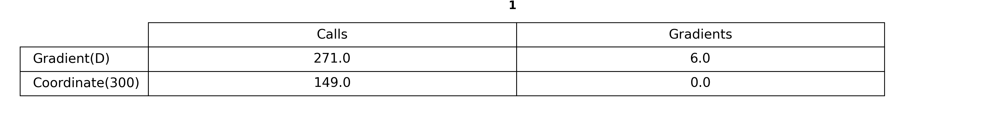

([[Point(coordinates=array([ 3.14159264,  3.14159264, -1.        ])),
   Point(coordinates=array([ 3.1415928,  3.1415928, -1.       ]))]],
  <matplotlib.animation.ArtistAnimation at 0x30fcd3eb0>])

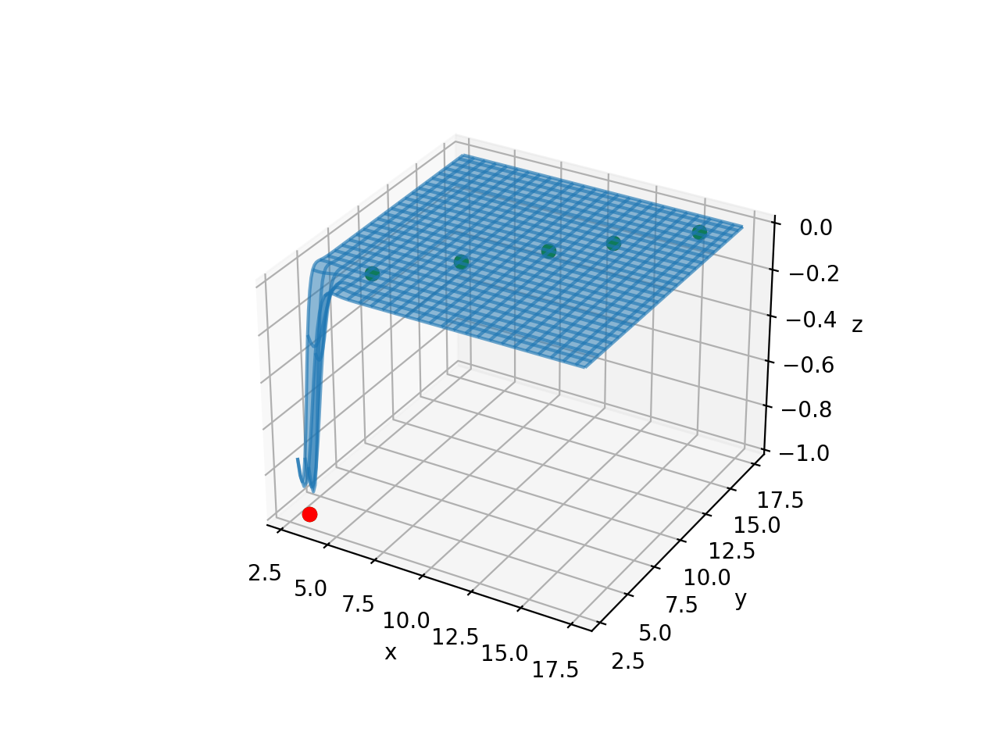

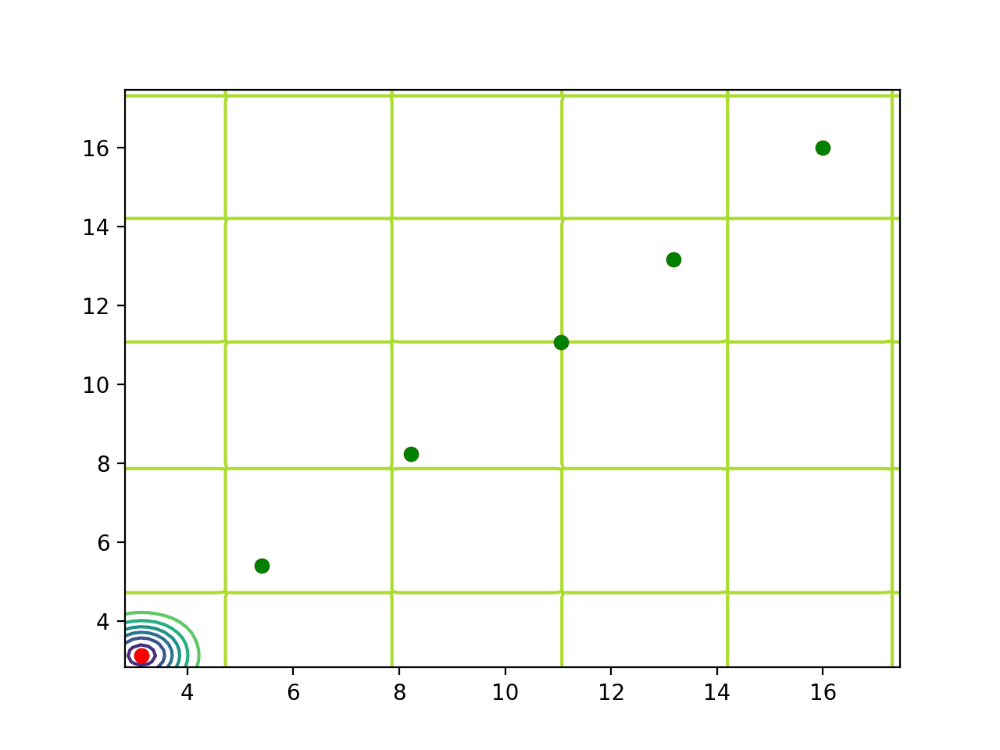

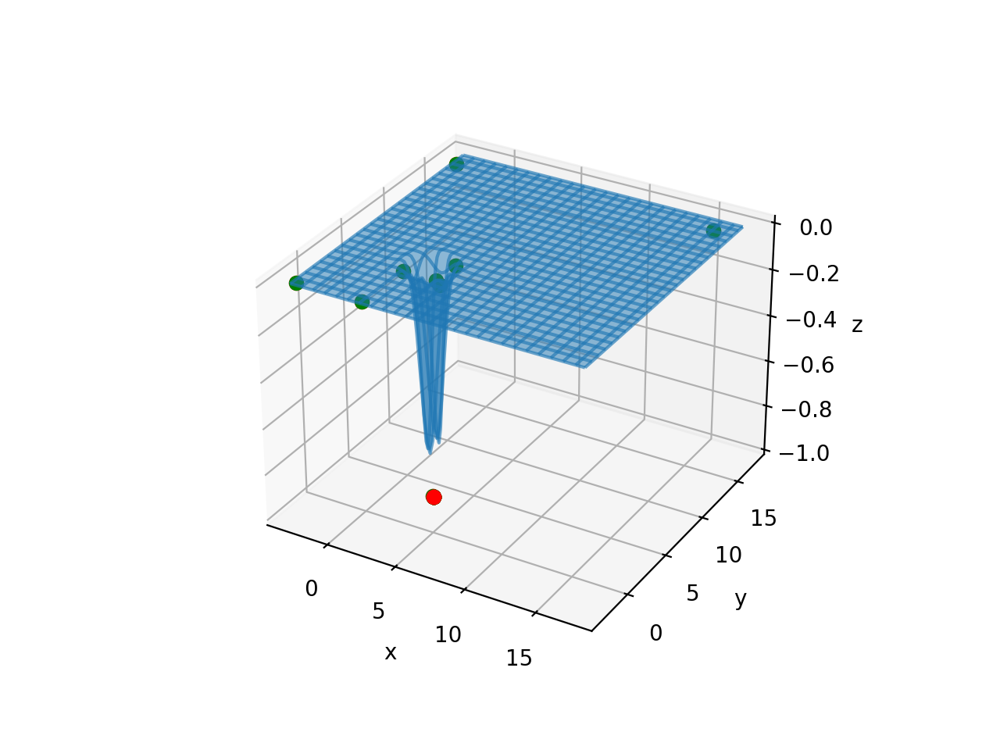

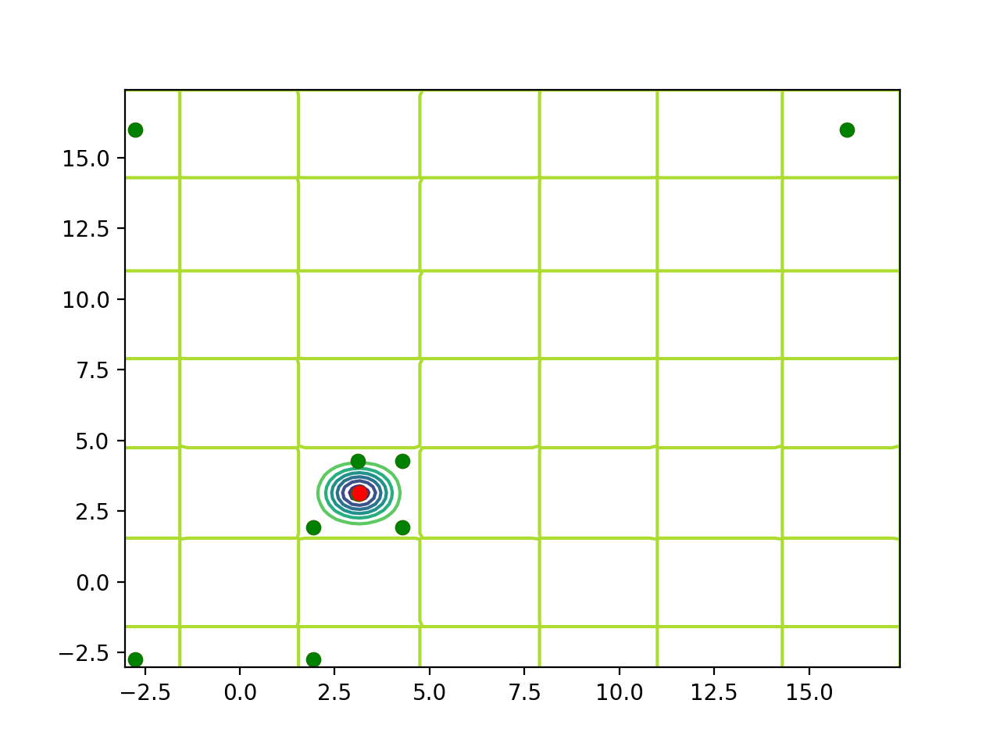

In [13]:
isom_function = GradientLambdaOracul(
    lambda x, y: -np.cos(x) * np.cos(y) * np.exp(-((x - np.pi) ** 2 + (y - np.pi) ** 2)),
    lambda x, y: np.array(
        [np.exp(-np.float64((x - np.pi)) ** 2 - (y - np.pi) ** 2) * np.cos(y)*(np.sin(x)+2*(x-np.pi)*np.cos(x)),
         np.exp(-np.float64((x - np.pi)) ** 2 - (y - np.pi) ** 2) * np.cos(x)*(np.sin(y)+2*(y-np.pi)*np.cos(y))],
        dtype=np.float64))
gradient_descent_golden_7 = GradientDescent(aprox_dec=10e-7)
gradient_descent_dichotomy_7 =  GradientDescent(method=DichotomyMethod(), aprox_dec=10e-7)
coordinate_descent_7 = CoordinateDescent(eps=10e-7)
Tester.test([gradient_descent_dichotomy_7, coordinate_descent_7],
            [isom_function], [CallCount(), GradientCount()],
            PrecisionCondition(10e-7), start_point=[16, 16], learning_rate=4, visualize=True)

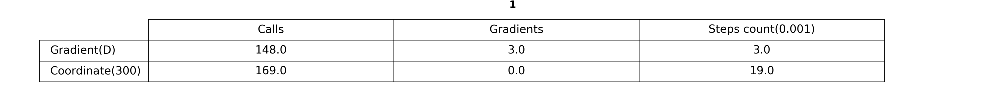

([[Point(coordinates=array([ 4.97819003e+00,  4.97819003e+00, -8.11022389e-05])),
   Point(coordinates=array([ 3.14159299,  3.14159299, -1.        ]))]],
 [None, None])

In [14]:
Tester.test([gradient_descent_dichotomy_7, coordinate_descent_7],
            [isom_function], [CallCount(), GradientCount(), abs_prec_3],
            PrecisionCondition(10e-7), start_point=[8, 8], learning_rate=10, visualize=False)

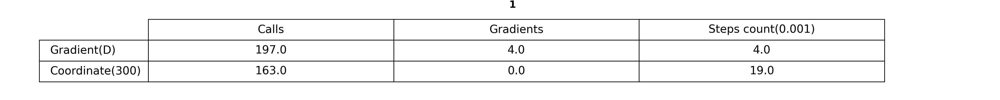

([[Point(coordinates=array([ 4.97819001e+00,  4.97819001e+00, -8.11022389e-05])),
   Point(coordinates=array([ 3.14159259,  3.14159259, -1.        ]))]],
 [None, None])

In [15]:
Tester.test([gradient_descent_dichotomy_7, coordinate_descent_7],
            [isom_function], [CallCount(), GradientCount(), abs_prec_3],
            PrecisionCondition(10e-7), start_point=[-10, -10], learning_rate=10, visualize=False)

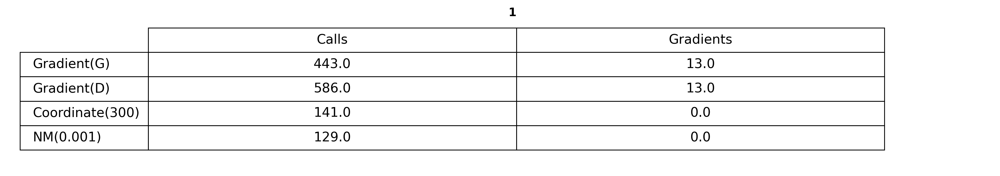

([[Point(coordinates=array([-2.80507496e+00,  3.13133232e+00,  7.72841744e-08])),
   Point(coordinates=array([-2.80506143e+00,  3.13132040e+00,  1.07331592e-07])),
   Point(coordinates=array([3.00025940e+00, 1.99966431e+00, 2.66373552e-06])),
   Point(coordinates=[2.9997201770749715, 2.097035460787211, 0.16692261197971303])]],
 [None, None, None, None])

In [16]:
base_mulltimodal = GradientLambdaOracul(lambda x, y: (x ** 2 + y - 11) ** 2 + (x + y ** 2 - 7) ** 2,
                                        lambda x, y: np.array([2 * (2 * x * (x ** 2 + y - 11) + x + y ** 2 - 7),
                                                               2 * (x ** 2 + 2 * y * (x + y ** 2 - 7) + y - 11)],
                                                              dtype=np.float64))

Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3], [base_mulltimodal],
            start_point=np.array([-1000, -2000]), metrics=[CallCount(), GradientCount()],
            stop_condition=PrecisionCondition(0.001))


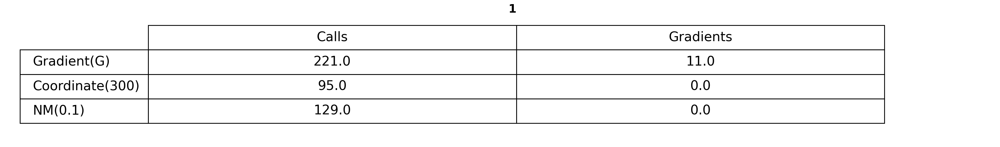

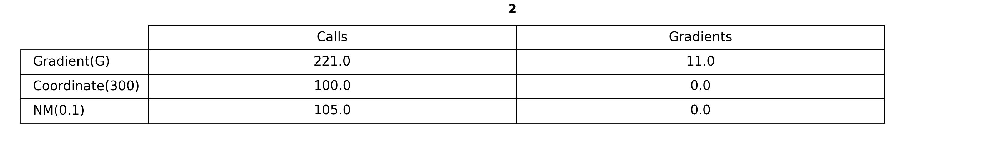

([[Point(coordinates=array([-2.80169721,  3.13023133, -0.00313336])),
   Point(coordinates=array([2.97851562, 2.00195312, 0.02117929])),
   Point(coordinates=[2.9997201770749715, 2.097035460787211, 0.16082909985819246])],
  [Point(coordinates=array([-0.01765598, -0.03531196,  0.00837866])),
   Point(coordinates=array([ 0.04882812, -0.04882812,  0.00290721])),
   Point(coordinates=[-0.16340143615707348, -0.29877883825975005, 0.12047478886313231])]],
 [None, None, None, None, None, None])

In [17]:
Tester.test([gradient_descent_golden_1, coordinate_descent_1, nm_1], [base_mulltimodal, base_test],
            start_point=np.array([-1000, -2000]), metrics=[CallCount(), GradientCount()],
            stop_condition=PrecisionCondition(0.1), noise=0.01)

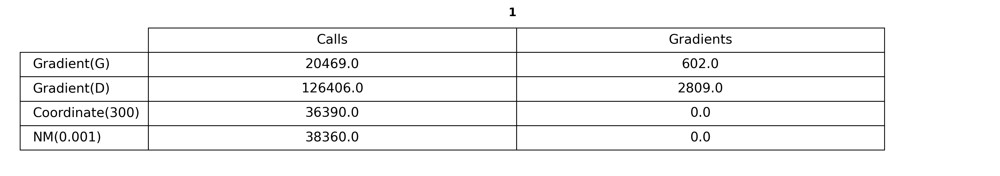

([[Point(coordinates=array([ 9.99974382e-01,  9.99963566e-01,  9.99955360e-01,  9.99949899e-01,
           9.99946843e-01,  9.99945479e-01,  9.99944907e-01,  9.99944238e-01,
           9.99942772e-01,  9.99940110e-01,  9.99936183e-01,  9.99931208e-01,
           9.99925586e-01,  9.99919790e-01,  9.99914256e-01,  9.99909315e-01,
           9.99905159e-01,  9.99901850e-01,  9.99899342e-01,  9.99897527e-01,
           9.99896265e-01,  9.99895420e-01,  9.99894869e-01,  9.99894516e-01,
           9.99894293e-01,  9.99894150e-01,  9.99894058e-01,  9.99893996e-01,
           9.99893953e-01,  9.99893924e-01,  9.99893903e-01,  9.99893888e-01,
           9.99893878e-01,  9.99893871e-01,  9.99893866e-01,  9.99893863e-01,
           9.99893861e-01,  9.99893860e-01,  9.99893860e-01,  9.99893859e-01,
           9.99893859e-01,  9.99893859e-01,  9.99893859e-01,  9.99893859e-01,
           9.99893859e-01,  9.99893859e-01,  9.99893859e-01,  9.99893859e-01,
           9.99893859e-01,  9.99893859e-01,  9

In [18]:

def f(params: np.ndarray, i: int) -> float:
    return 100 * (params[i] - params[i - 1] ** 2) ** 2 + (1 - params[i - 1]) ** 2


def grad(params: np.ndarray):
    res = []
    for j in range(len(params)):
        if j == 0:
            res.append(-400 * params[0] * (params[1] - params[0] ** 2) - 2 * (1 - params[0]))
        elif j == len(params) - 1:
            res.append(200 * (params[j] - params[j - 1] ** 2))
        else:
            res.append(
                200 * (params[j] - params[j - 1] ** 2) - 400 * params[j] * (params[j + 1] - params[j] ** 2) - 2 * (
                        1 - params[j]))
    return np.array(res, dtype=np.float64)


oracul1 = MultiGradientLambdaOracul(f, grad, 20, start_sum=1)
oracul2 = MultiGradientLambdaOracul(f, grad, 100, start_sum=1)
Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3],
            [oracul2], start_point=np.array([100 for _ in range(100)]),
            metrics=[CallCount(), GradientCount()], stop_condition=PrecisionCondition(0.001))

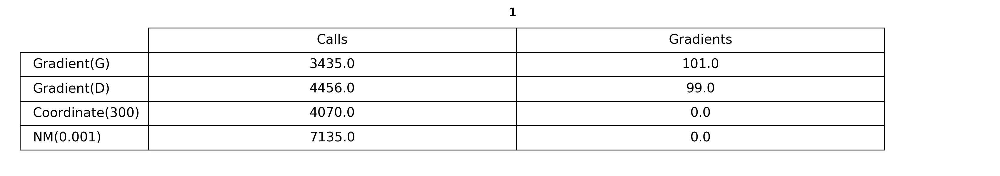

([[Point(coordinates=array([  1.01841889,   1.02548094,   1.03026352,   1.0331878 ,
            1.03482139,   1.03566443,   1.03608052,   1.03632018,
            1.03660365,   1.03728006,   1.0391547 ,   1.04419739,
            1.05706108,   1.08832561,   1.16193651,   1.33591057,
            1.77876621,   3.16421559,  10.01584002, 100.31901429,
           88.19306485])),
   Point(coordinates=array([  1.01542883,   1.0214452 ,   1.02561477,   1.02823251,
            1.02973815,   1.03054153,   1.03095699,   1.03121778,
            1.03155166,   1.03233936,   1.03444537,   1.03992262,
            1.05350019,   1.08575258,   1.16045329,   1.33530899,
            1.77862501,   3.16419845,  10.01576815, 100.31836933,
           87.76939416])),
   Point(coordinates=array([ 9.99450684e-01,  9.99450684e-01,  9.99450684e-01,  9.99450684e-01,
           9.98306274e-01,  9.97161865e-01,  9.94873047e-01,  9.89151001e-01,
           9.78851318e-01,  9.57107544e-01,  9.14764404e-01,  8.36944580e-01

In [19]:
Tester.test([gradient_descent_golden, gradient_descent_dichotomy, coordinate_descent_3, nm_3],
            [oracul1], start_point=np.array([100 for _ in range(20)]),
            metrics=[CallCount(), GradientCount()], stop_condition=PrecisionCondition(0.001))

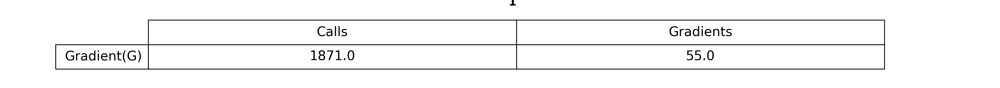

([[Point(coordinates=array([1.7044485 , 9.93505479, 1.42663265]))]],
 [<matplotlib.animation.ArtistAnimation at 0x30f9a9a90>])

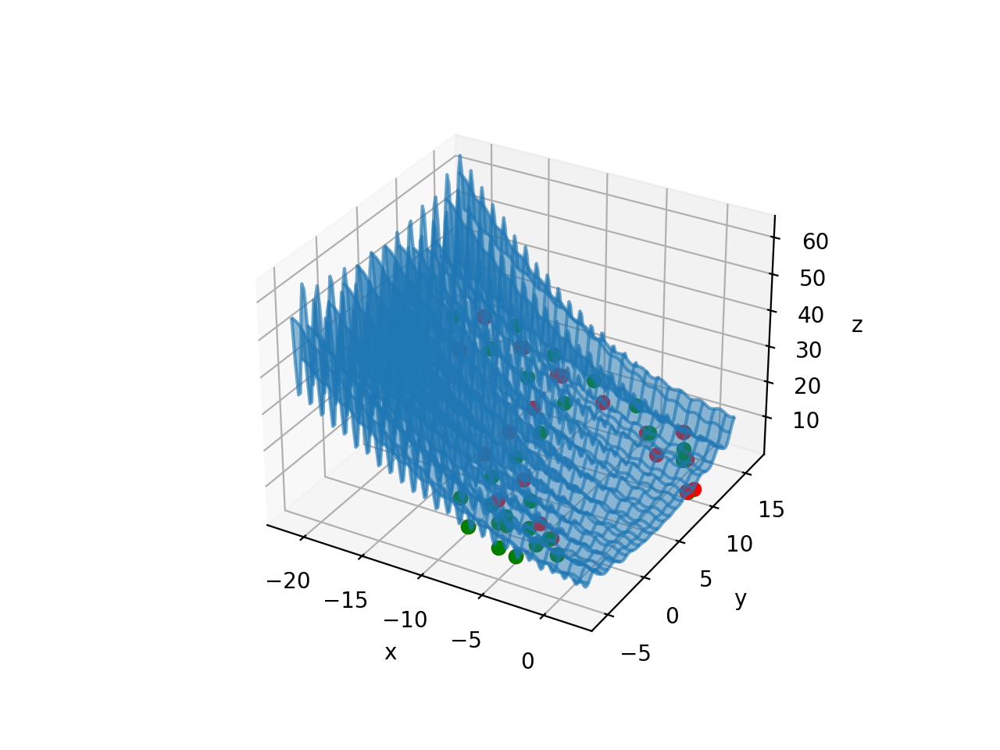

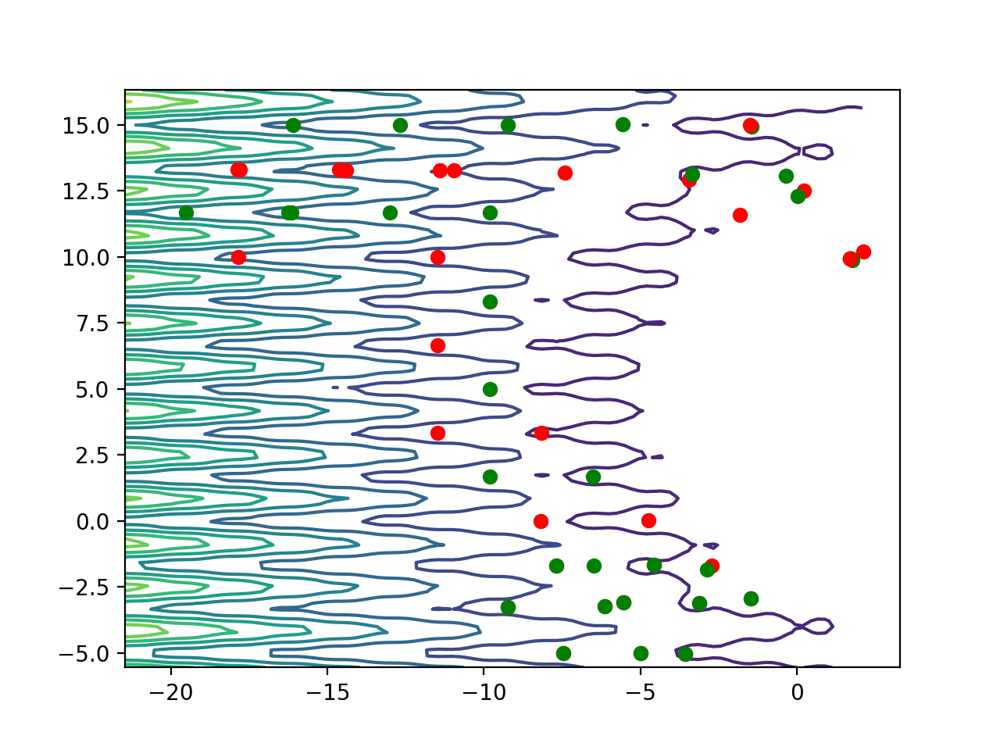

In [20]:
def levi_function(x, y):
    FACTOR = 5
    return (np.sin(3 / FACTOR * np.pi * x)**2
            + (x / FACTOR - 1)**2 * (1 + np.sin(3 * np.pi * y / FACTOR)**2)
            + (y / FACTOR - 1)**2 * (1 + np.sin(2 * np.pi * y / FACTOR)**2))

def levi_function_gradient(x, y):
    xval = (6 / 5 * np.pi * np.cos(3 * np.pi * x / 5) * np.sin(3 * np.pi * x / 5)  
            + (2/25 * (-5 + x) * (1 + np.sin(3 * np.pi * y / 5) ** 2)))
    yval = 2 /125* (2 * np.pi * (-5 + y)**2 * np.cos(2 * np.pi * y / 5) * np.sin(2 * np.pi * y/5) + 5 * (-5 + y) * (1 + np.sin(2 * np.pi * y/5)**2) + 3 * np.pi * (-5 + x)**2 * np.cos(3 * np.pi * y/5) * np.sin(3 * np.pi * y/5))

    return np.array([xval, yval])

levi_oracul = GradientLambdaOracul(
    func=levi_function,
    gradient_func=levi_function_gradient
)
Tester.test([GradientDescent(method=GoldenRatioMethod(), aprox_dec=10e-7)],
            [levi_oracul], start_point=np.array([-5, -5]),
            metrics=[CallCount(), GradientCount()], stop_condition=OrCondition(CountCondition(1000), PrecisionCondition(10e-7)), learning_rate=3, visualize=True)


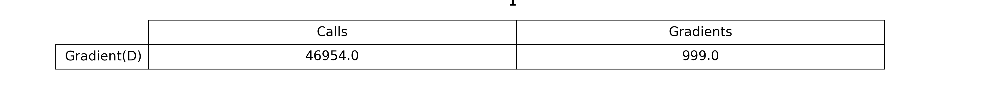

([[Point(coordinates=array([3.39180835, 4.59711498, 0.17260998]))]], [None])

In [21]:
Tester.test([GradientDescent(method=DichotomyMethod(), aprox_dec=10e-7)],
            [levi_oracul], start_point=np.array([10, -6]),
            metrics=[CallCount(), GradientCount()], stop_condition=OrCondition(CountCondition(1000), PrecisionCondition(10e-7)), learning_rate=5, visualize=False)

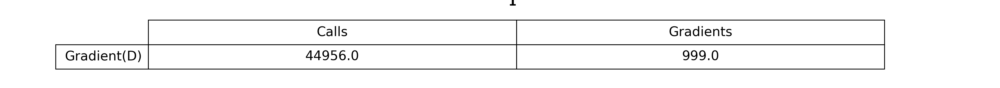

([[Point(coordinates=array([3.4294447 , 3.23205248, 0.33883712]))]],
 [<matplotlib.animation.ArtistAnimation at 0x3676f4340>])

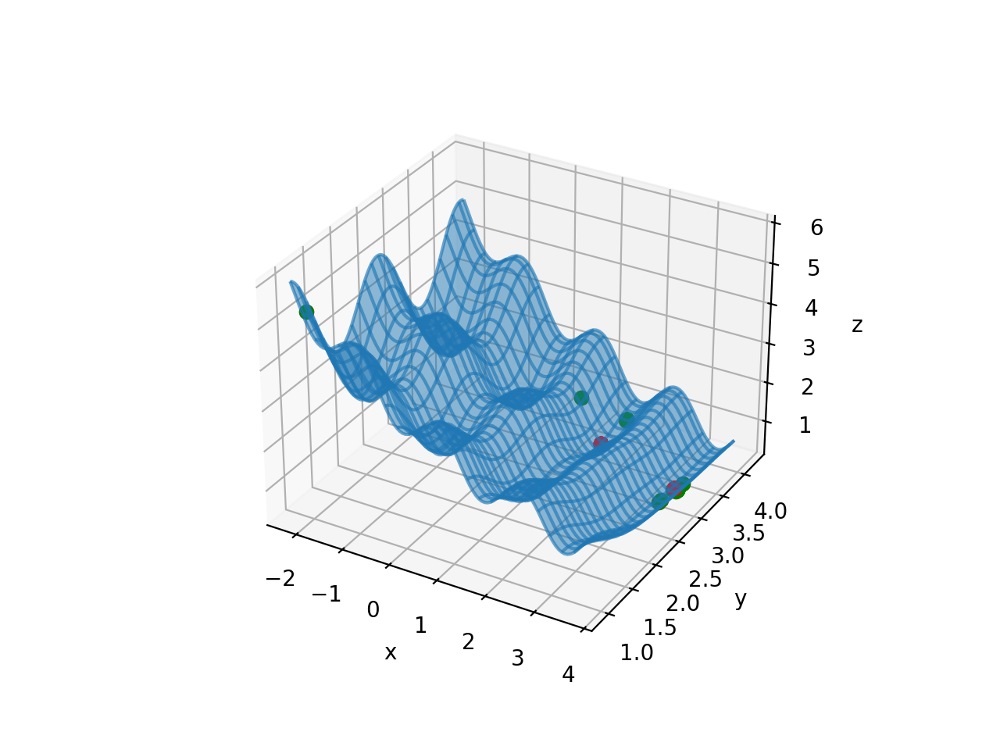

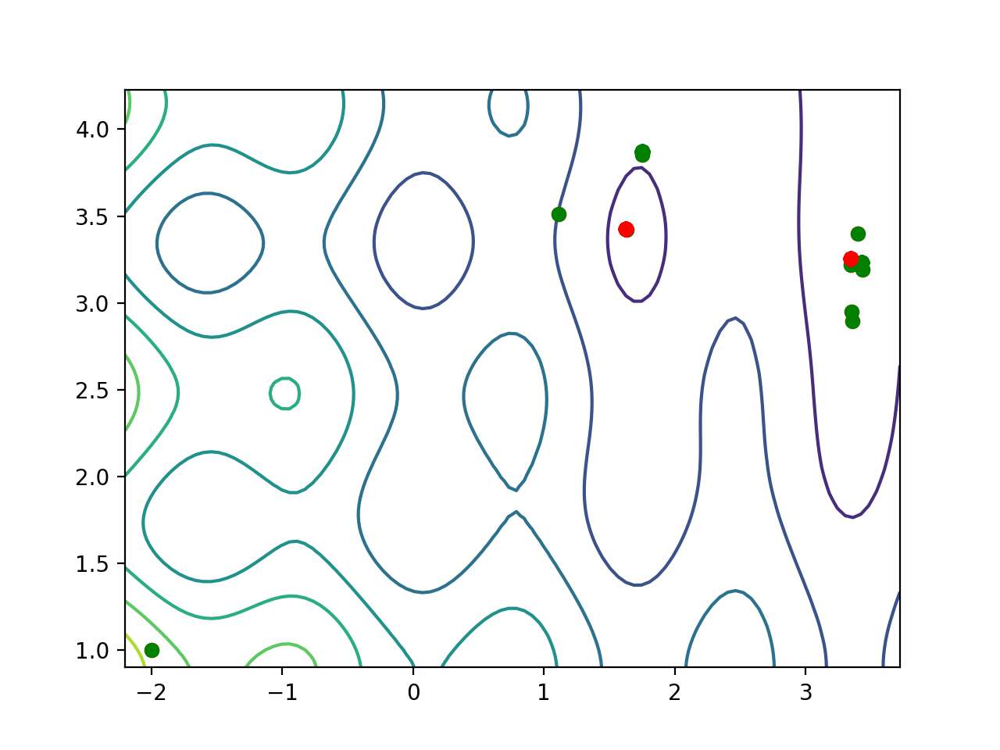

In [22]:
Tester.test([GradientDescent(method=DichotomyMethod(), aprox_dec=10e-7)],
            [levi_oracul], start_point=np.array([-2, 1]),
            metrics=[CallCount(), GradientCount()], stop_condition=OrCondition(CountCondition(1000), PrecisionCondition(10e-7)), learning_rate=4, visualize=True)

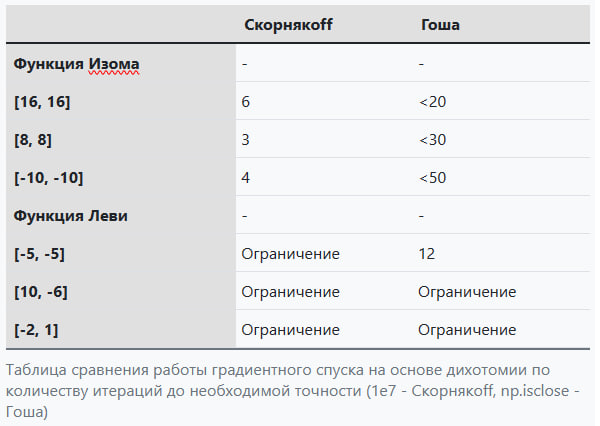

In [23]:
Image('images/compare-table.png')